# Clustering

## Import Libaries and Dataset

In [232]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from wordcloud import WordCloud

import re
import nltk
from nltk.tokenize import word_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.cluster import KMeans
from sklearn.decomposition import IncrementalPCA
import plotly.express as px

# pickle file
import pickle

import warnings
warnings.filterwarnings('ignore')

In [45]:
df_1 = pd.read_csv('Tokopedia.csv')
df_1

,id,created_at,score,content,thumbsUpCount
0,0,2024-10-24 16:51,5,"Untuk pengembang, tolong yang sistem ""BEBAS ON...",53
1,1,2024-10-23 22:49,5,Saya pelanggan setia tokopedia. Setelah bertah...,70
2,2,2024-10-21 08:58,3,Saran - selagi masih dengan JNE yang banyak ke...,69
3,3,2024-10-17 05:33,3,UI/UX bagusan sebelum nya. Wishlist taruh di n...,115
4,4,2024-10-20 15:42,1,Kecewa sekali. Baru pertama kali daftar dan ni...,59
...,...,...,...,...,...
71237,71237,2022-04-20 13:59,1,Pembatalan pembelian dari pihak Tokopedia Sewe...,0
71238,71238,2024-03-30 21:33,1,"Pembayaran Gopaylater Tidak Tersedia, padahal ...",0
71239,71239,2020-09-16 10:25,5,"Sangat membantu,,pelatihan nya mudah di menger...",2
71240,71240,2024-03-16 14:29,1,Aplikasi penipu !!!refund dana saya ga masuk2 ...,27


There is a negative review but it is rated 5

## Exploratory Data Analysis (EDA)

### Check Data Type

In [247]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71242 entries, 0 to 71241
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   id             71242 non-null  int64 
 1   created_at     71242 non-null  object
 2   score          71242 non-null  int64 
 3   content        71242 non-null  object
 4   thumbsUpCount  71242 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 2.7+ MB


### Pie Chart

In [88]:
score = df_1['score']

score_counts = score.value_counts().sort_values(ascending=False)
score_counts

score
5    31562
1    26175
2     4883
3     4585
4     4037
Name: count, dtype: int64

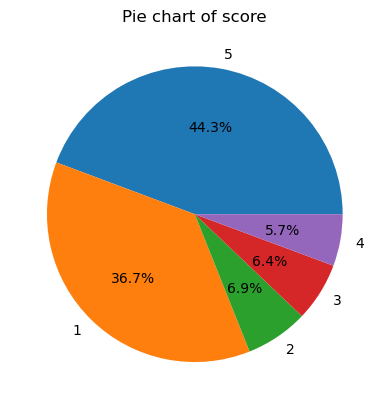

In [90]:
# create a pie chart
plt.pie(score_counts, labels=score_counts.index, autopct='%1.1f%%')

# add title
plt.title('Pie chart of score')

# show the plot
plt.show()

### Word cloud

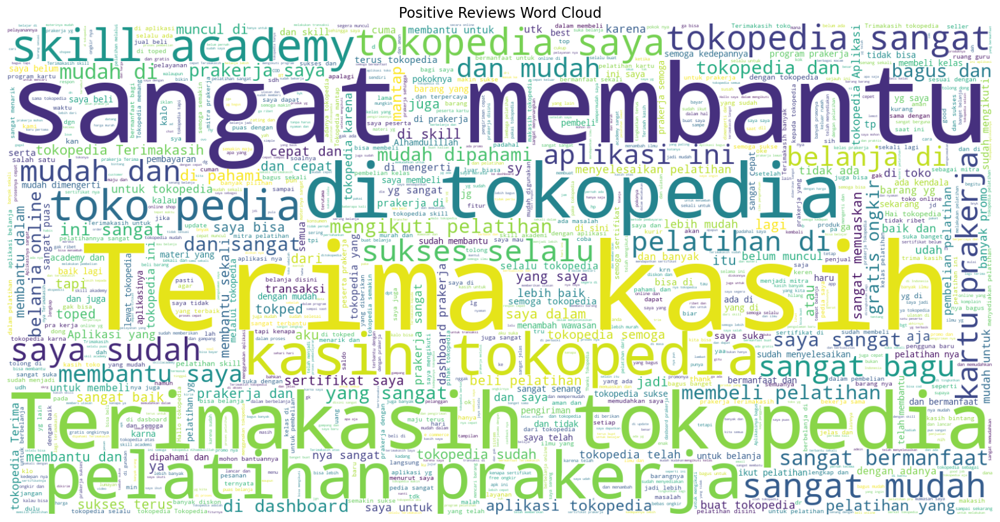

In [92]:
pos_rev_df = df_1[df_1['score'] == 5]
pos_rev = ' '.join(pos_rev_df['content'].astype(str))

# Create the WordCloud object and assign it to wc
wc = WordCloud(
    max_words=1000,
    width=1600,
    height=800,
    background_color='white',
    colormap='viridis'
).generate(pos_rev)

plt.figure(figsize=(20, 20))
plt.axis('off')
plt.title("Positive Reviews Word Cloud", fontsize=16)
plt.imshow(wc, interpolation='bilinear')
plt.show()

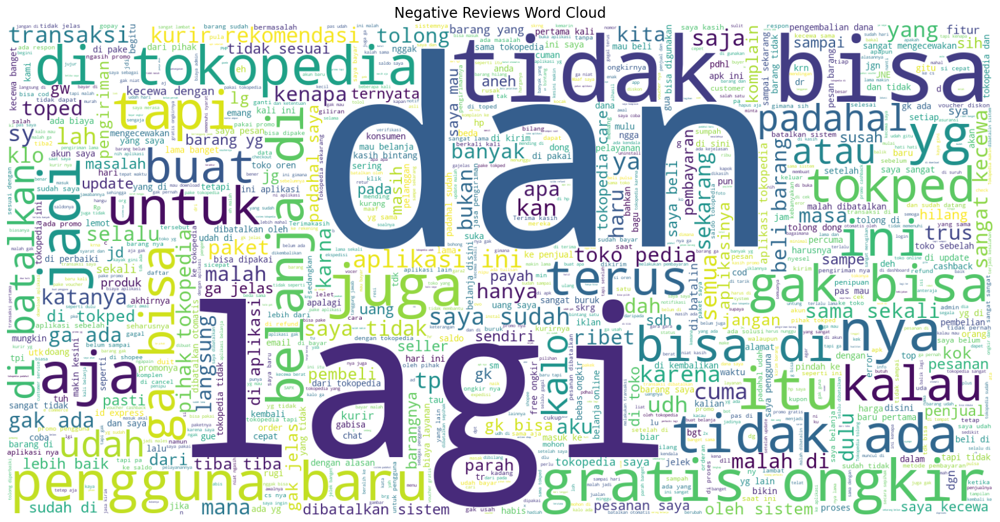

In [94]:
neg_rev_df = df_1[df_1['score'] == 1]
neg_rev = ' '.join(neg_rev_df['content'].astype(str))

# Create the WordCloud object and assign it to wc
wc = WordCloud(
    max_words=1000,
    width=1600,
    height=800,
    background_color='white',
    colormap='viridis'
).generate(neg_rev)

plt.figure(figsize=(20, 20))
plt.axis('off')
plt.title("Negative Reviews Word Cloud", fontsize=16)
plt.imshow(wc, interpolation='bilinear')
plt.show()

## Data Pre-processing

### Drop Columns and Duplicate values

In [102]:
df_2 = df_1.copy()
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71242 entries, 0 to 71241
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   id             71242 non-null  int64 
 1   created_at     71242 non-null  object
 2   score          71242 non-null  int64 
 3   content        71242 non-null  object
 4   thumbsUpCount  71242 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 2.7+ MB


In [104]:
df_2.drop(columns = ['id', 'created_at', 'score', 'thumbsUpCount'], inplace=True)
df_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71242 entries, 0 to 71241
Data columns (total 1 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   content  71242 non-null  object
dtypes: object(1)
memory usage: 556.7+ KB


In [106]:
df_2.duplicated().sum()

303

In [108]:
df_2.drop_duplicates(inplace=True)
df_2.duplicated().sum()

0

### Cleaning Text

In [110]:
!pip install Sastrawi

In [112]:
# import StemmerFactory class
from Sastrawi.Stemmer.StemmerFactory import StemmerFactory

# create stemmer
factory = StemmerFactory()
stemmer = factory.create_stemmer()

# stemming process
sentence = 'Perekonomian Indonesia sedang dalam pertumbuhan yang membanggakan'
output   = stemmer.stem(sentence)

print(output)
# ekonomi indonesia sedang dalam tumbuh yang bangga

print(stemmer.stem('Mereka meniru-nirukannya'))
# mereka tiru

ekonomi indonesia sedang dalam tumbuh yang bangga
mereka tiru


In [114]:
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [116]:
from nltk.corpus import stopwords

def clean(Text):
    text = re.sub('[^a-zA-Z]', ' ', Text) #Replacing all non-alphabetic characters with a space
    text = text.lower() #converting to lowecase
    text = word_tokenize(text)
    text = [stemmer.stem(word) for word in text if not word in stopwords.words("indonesian")]
    text = ' '.join(text)
    return text

df_2["clean_text"] = df_2["content"].apply(clean)
df_2.head()

,content,clean_text
0,"Untuk pengembang, tolong yang sistem ""BEBAS ON...",kembang tolong sistem bebas ongkir rekomendasi...
1,Saya pelanggan setia tokopedia. Setelah bertah...,langgan setia tokopedia tahun belanja tokopedi...
2,Saran - selagi masih dengan JNE yang banyak ke...,saran selagi jne kurang update status barang t...
3,UI/UX bagusan sebelum nya. Wishlist taruh di n...,ui ux bagus nya wishlist taruh navbar udah bag...
4,Kecewa sekali. Baru pertama kali daftar dan ni...,kecewa kali daftar niat chekout first time krn...


### Vectorization 

In [121]:
#Changing text data in to numbers.
tfidf = TfidfVectorizer()
X = tfidf.fit_transform(df_2["clean_text"])

#Let's have a look at our feature
X.dtype

dtype('float64')

## Modelling

### Dementional Reduction

In [177]:
ipca = IncrementalPCA(n_components=3, batch_size=1000)

# Transform the data
X_pca = ipca.fit_transform(X)

# Create a DataFrame for the transformed data
X_pca_df = pd.DataFrame(data=X_pca, columns=['X1', 'X2', 'X3'])
X_pca_df

,X1,X2,X3
0,-0.118321,0.091198,-0.143474
1,-0.057236,0.148570,0.054079
2,-0.101087,0.071641,-0.024737
3,-0.075919,-0.008798,-0.001814
4,-0.127131,-0.089230,0.116575
...,...,...,...
70934,-0.063913,-0.021880,0.046777
70935,-0.069968,-0.025072,0.031665
70936,0.188414,-0.019471,-0.020001
70937,-0.065563,-0.022871,0.027019


In [178]:
kmeans = KMeans(n_clusters=2, random_state=42).fit(X)
labels = kmeans.labels_

X_pca_df['Labels'] = labels
X_pca_df['Labels'] = X_pca_df['Labels'].astype(str)
X_pca_df

,X1,X2,X3,Labels
0,-0.118321,0.091198,-0.143474,1
1,-0.057236,0.148570,0.054079,1
2,-0.101087,0.071641,-0.024737,1
3,-0.075919,-0.008798,-0.001814,1
4,-0.127131,-0.089230,0.116575,1
...,...,...,...,...
70934,-0.063913,-0.021880,0.046777,1
70935,-0.069968,-0.025072,0.031665,1
70936,0.188414,-0.019471,-0.020001,0
70937,-0.065563,-0.022871,0.027019,1


### Visualization of Clustering Results

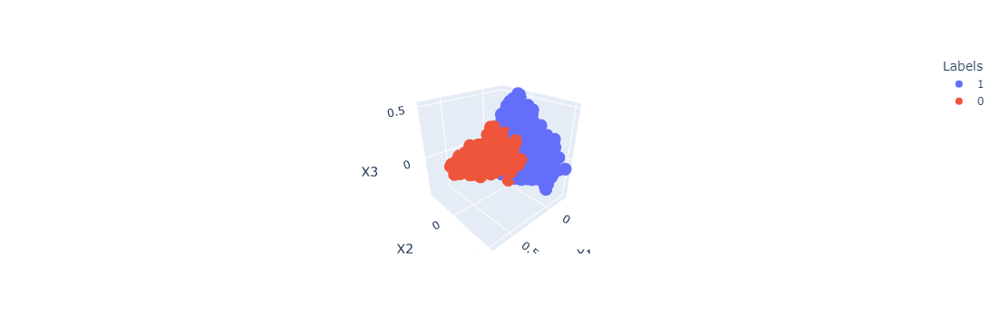

In [182]:
fig = px.scatter_3d(X_pca_df, x='X1', y='X2', z='X3',
                    color=X_pca_df['Labels'])
fig.show()

In [224]:
results_df = df_2.copy()

results_df.drop(columns = 'clean_text', inplace=True)
results_df['Labels'] = kmeans.labels_
results_df

,content,Labels
0,"Untuk pengembang, tolong yang sistem ""BEBAS ON...",1
1,Saya pelanggan setia tokopedia. Setelah bertah...,1
2,Saran - selagi masih dengan JNE yang banyak ke...,1
3,UI/UX bagusan sebelum nya. Wishlist taruh di n...,1
4,Kecewa sekali. Baru pertama kali daftar dan ni...,1
...,...,...
71237,Pembatalan pembelian dari pihak Tokopedia Sewe...,1
71238,"Pembayaran Gopaylater Tidak Tersedia, padahal ...",1
71239,"Sangat membantu,,pelatihan nya mudah di menger...",0
71240,Aplikasi penipu !!!refund dana saya ga masuk2 ...,1


In [226]:
results_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 70939 entries, 0 to 71241
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   content  70939 non-null  object
 1   Labels   70939 non-null  int32 
dtypes: int32(1), object(1)
memory usage: 1.4+ MB


In [228]:
results_df["Labels"] = results_df["Labels"].map({ 0: "Positive", 1: "Negative"})
results_df

,content,Labels
0,"Untuk pengembang, tolong yang sistem ""BEBAS ON...",Negative
1,Saya pelanggan setia tokopedia. Setelah bertah...,Negative
2,Saran - selagi masih dengan JNE yang banyak ke...,Negative
3,UI/UX bagusan sebelum nya. Wishlist taruh di n...,Negative
4,Kecewa sekali. Baru pertama kali daftar dan ni...,Negative
...,...,...
71237,Pembatalan pembelian dari pihak Tokopedia Sewe...,Negative
71238,"Pembayaran Gopaylater Tidak Tersedia, padahal ...",Negative
71239,"Sangat membantu,,pelatihan nya mudah di menger...",Positive
71240,Aplikasi penipu !!!refund dana saya ga masuk2 ...,Negative


In [234]:
results_df.to_csv("clustering.csv")

# Classification

## Import Libaries and Dataset

In [281]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import re
import nltk
from imblearn.under_sampling import NearMiss
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from nltk.tokenize import word_tokenize

from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

from sklearn.model_selection import GridSearchCV

import pickle

import warnings
warnings.filterwarnings('ignore')

In [242]:
df_3 = pd.read_csv('clustering.csv')
df_3

,Unnamed: 0,content,Labels
0,0,"Untuk pengembang, tolong yang sistem ""BEBAS ON...",Negative
1,1,Saya pelanggan setia tokopedia. Setelah bertah...,Negative
2,2,Saran - selagi masih dengan JNE yang banyak ke...,Negative
3,3,UI/UX bagusan sebelum nya. Wishlist taruh di n...,Negative
4,4,Kecewa sekali. Baru pertama kali daftar dan ni...,Negative
...,...,...,...
70934,71237,Pembatalan pembelian dari pihak Tokopedia Sewe...,Negative
70935,71238,"Pembayaran Gopaylater Tidak Tersedia, padahal ...",Negative
70936,71239,"Sangat membantu,,pelatihan nya mudah di menger...",Positive
70937,71240,Aplikasi penipu !!!refund dana saya ga masuk2 ...,Negative


## Exploratory Data Analysis (EDA)

In [245]:
df_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70939 entries, 0 to 70938
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Unnamed: 0  70939 non-null  int64 
 1   content     70939 non-null  object
 2   Labels      70939 non-null  object
dtypes: int64(1), object(2)
memory usage: 1.6+ MB


### Pie Chart

In [252]:
label = df_3['Labels']

label_counts = label.value_counts().sort_values(ascending=False)
label_counts

Labels
Negative    56658
Positive    14281
Name: count, dtype: int64

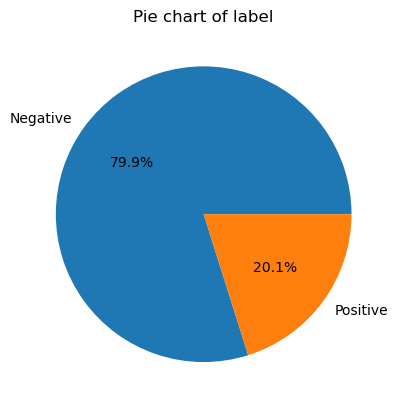

In [254]:
# create a pie chart
plt.pie(label_counts, labels=label_counts.index, autopct='%1.1f%%')

# add title
plt.title('Pie chart of label')

# show the plot
plt.show()

Imbalanced dataset

### Word Cloud

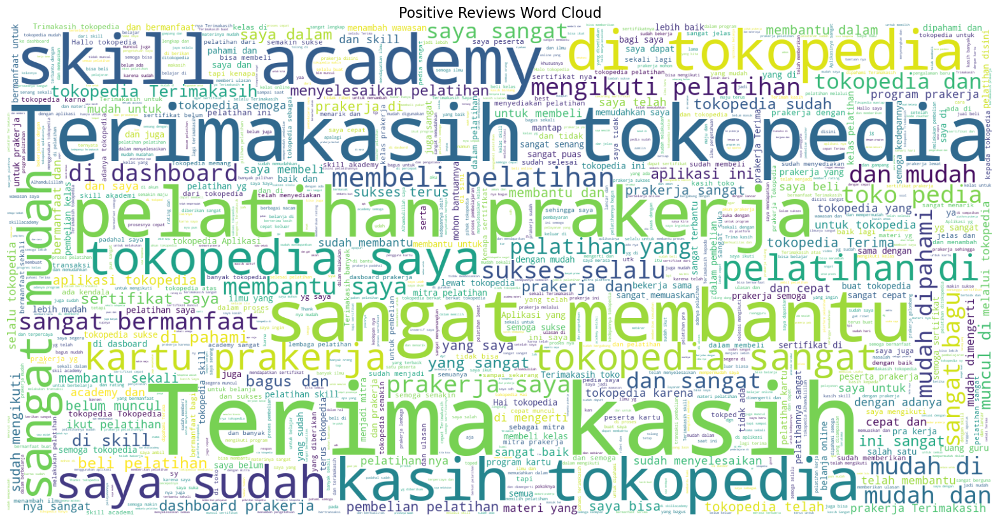

In [330]:
pos_rev_df = df_3[df_3['Labels'] == 'Positive']
pos_rev = ' '.join(pos_rev_df['content'].astype(str))

# Create the WordCloud object and assign it to wc
wc = WordCloud(
    max_words=1000,
    width=1600,
    height=800,
    background_color='white',
    colormap='viridis'
).generate(pos_rev)

plt.figure(figsize=(20, 20))
plt.axis('off')
plt.title("Positive Reviews Word Cloud", fontsize=16)
plt.imshow(wc, interpolation='bilinear')
plt.show()

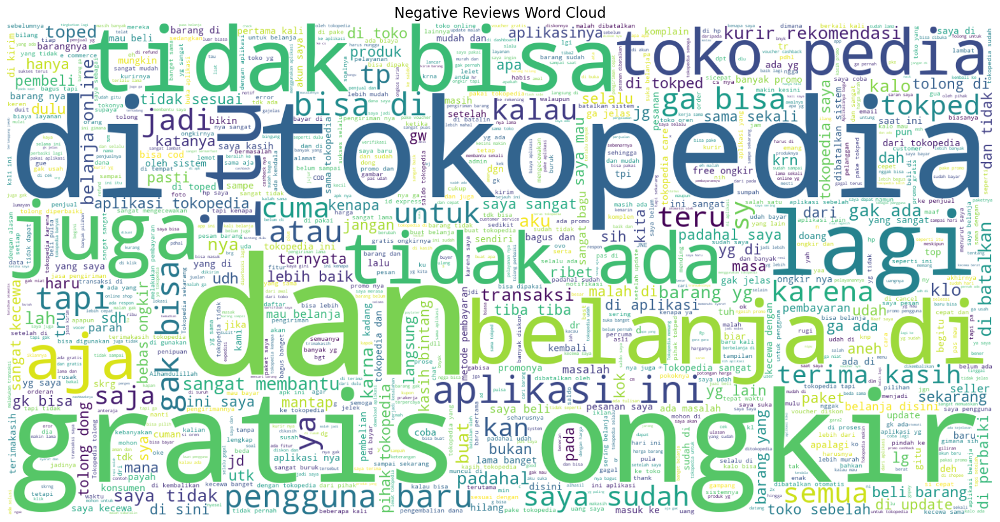

In [332]:
neg_rev_df = df_3[df_3['Labels'] == 'Negative']
neg_rev = ' '.join(neg_rev_df['content'].astype(str))

# Create the WordCloud object and assign it to wc
wc = WordCloud(
    max_words=1000,
    width=1600,
    height=800,
    background_color='white',
    colormap='viridis'
).generate(neg_rev)

plt.figure(figsize=(20, 20))
plt.axis('off')
plt.title("Negative Reviews Word Cloud", fontsize=16)
plt.imshow(wc, interpolation='bilinear')
plt.show()

## Data Preprocessing

### Drop Column

In [263]:
df_4 = df_3.copy()
df_4.drop(columns = 'Unnamed: 0', inplace=True)
df_4

,content,Labels
0,"Untuk pengembang, tolong yang sistem ""BEBAS ON...",Negative
1,Saya pelanggan setia tokopedia. Setelah bertah...,Negative
2,Saran - selagi masih dengan JNE yang banyak ke...,Negative
3,UI/UX bagusan sebelum nya. Wishlist taruh di n...,Negative
4,Kecewa sekali. Baru pertama kali daftar dan ni...,Negative
...,...,...
70934,Pembatalan pembelian dari pihak Tokopedia Sewe...,Negative
70935,"Pembayaran Gopaylater Tidak Tersedia, padahal ...",Negative
70936,"Sangat membantu,,pelatihan nya mudah di menger...",Positive
70937,Aplikasi penipu !!!refund dana saya ga masuk2 ...,Negative


### Check duplicated value

In [269]:
df_4['content'].duplicated().sum()

0

### Clean Text

In [272]:
!pip install Sastrawi

In [274]:
# import StemmerFactory class
from Sastrawi.Stemmer.StemmerFactory import StemmerFactory

# create stemmer
factory = StemmerFactory()
stemmer = factory.create_stemmer()

# stemming process
sentence = 'Perekonomian Indonesia sedang dalam pertumbuhan yang membanggakan'
output   = stemmer.stem(sentence)

print(output)
# ekonomi indonesia sedang dalam tumbuh yang bangga

print(stemmer.stem('Mereka meniru-nirukannya'))
# mereka tiru

ekonomi indonesia sedang dalam tumbuh yang bangga
mereka tiru


In [276]:
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\MARULI\AppData\Roaming\nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [283]:
from nltk.corpus import stopwords

def clean(Text):
    text = re.sub('[^a-zA-Z]', ' ', Text) #Replacing all non-alphabetic characters with a space
    text = text.lower() #converting to lowecase
    text = word_tokenize(text)
    text = [stemmer.stem(word) for word in text if not word in stopwords.words("indonesian")]
    text = ' '.join(text)
    return text

df_4["clean_text"] = df_4["content"].apply(clean)
df_4.head()

,content,Labels,clean_text
0,"Untuk pengembang, tolong yang sistem ""BEBAS ON...",Negative,kembang tolong sistem bebas ongkir rekomendasi...
1,Saya pelanggan setia tokopedia. Setelah bertah...,Negative,langgan setia tokopedia tahun belanja tokopedi...
2,Saran - selagi masih dengan JNE yang banyak ke...,Negative,saran selagi jne kurang update status barang t...
3,UI/UX bagusan sebelum nya. Wishlist taruh di n...,Negative,ui ux bagus nya wishlist taruh navbar udah bag...
4,Kecewa sekali. Baru pertama kali daftar dan ni...,Negative,kecewa kali daftar niat chekout first time krn...


### Vectorization

In [316]:
df_4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70939 entries, 0 to 70938
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   content     70939 non-null  object
 1   Labels      70939 non-null  object
 2   clean_text  70939 non-null  object
dtypes: object(3)
memory usage: 1.6+ MB


In [318]:
#Changing text data in to numbers.
tfidf = TfidfVectorizer()
X = tfidf.fit_transform(df_4["clean_text"])

#Let's have a look at our feature
X.dtype

dtype('float64')

In [320]:
pickle.dump(tfidf, open('vectorization.pkl', 'wb'))

### Undersampling and Splitting the Dataset Into the Training Set and Test Set

In [322]:
#Setting values for labels and feature as y and X(we already did X in vectorizing...)
y = df_4["Labels"]

nearmiss = NearMiss(sampling_strategy='majority')

X, y = nearmiss.fit_resample(X, y)

y.value_counts()

Labels
Negative    14281
Positive    14281
Name: count, dtype: int64

In [324]:
# Splitting the testing and training sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(22849, 33045)
(5713, 33045)
(22849,)
(5713,)


## Modelling

In [327]:
def classification_eval(actual, predict, name):

  cm = confusion_matrix(actual, predict)
  # plot confusion matrix
  plt.figure(figsize=(8,6))
  sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False,
              xticklabels=['Positive', 'Negative'],
              yticklabels=['Positive', 'Negative'])
  plt.xlabel('Predicted Labels')
  plt.ylabel('Actual Lables')
  plt.title(f'Confusion Matrix - {name}')
  plt.show()

  print(classification_report(actual, predict))

In [334]:
models = {
    'Naive Bayes': MultinomialNB(),
    'Logistic Regression': LogisticRegression(),
    'K-NN': KNeighborsClassifier(),
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'Support Vector Machine': SVC()
}

results = []

for model_name, model in models.items():
    model.fit(X_train, y_train)
    
    y_pred_train = model.predict(X_train)
    y_pred_test = model.predict(X_test)

    accuracy_train = accuracy_score(y_train, y_pred_train)
    accuracy_test = accuracy_score(y_test, y_pred_test)
    
    results.append({'Model': model_name, 'Train Accuracy': accuracy_train, 'Test Accuracy': accuracy_test})

df_accuracy = pd.DataFrame(results).sort_values(by=['Train Accuracy', 'Test Accuracy'], ascending=[False, False])
df_accuracy

,Model,Train Accuracy,Test Accuracy
3,Decision Tree,1.000000,0.945738
4,Random Forest,1.000000,0.944162
5,Support Vector Machine,0.999825,0.985647
1,Logistic Regression,0.995886,0.990023
0,Naive Bayes,0.915532,0.902503
2,K-NN,0.831152,0.806757


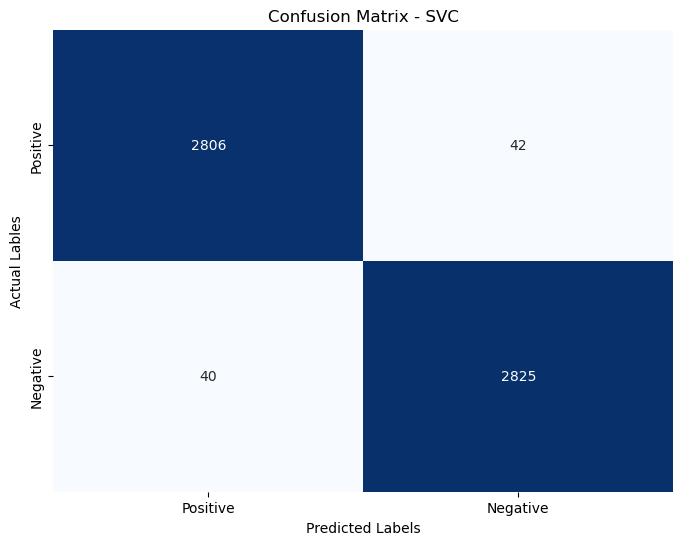

              precision    recall  f1-score   support

    Negative       0.99      0.99      0.99      2848
    Positive       0.99      0.99      0.99      2865

    accuracy                           0.99      5713
   macro avg       0.99      0.99      0.99      5713
weighted avg       0.99      0.99      0.99      5713



In [353]:
svc = SVC()

svc.fit(X_train, y_train)
y_pred_svc = svc.predict(X_test)

classification_eval(y_test, y_pred_svc, 'SVC')

 ## Tuning Model

In [361]:
svc = SVC(random_state=42)

# define parameters for GridSearchCV
parameters = {'C': [0.1, 1, 10, 100, 1000],
              'gamma': ['scale', 'auto'],
              'kernel': ['linear', 'rbf'],
              'decision_function_shape': ['ovo', 'ovr']}

grid_search = GridSearchCV(estimator=svc, param_grid=parameters, cv=3, verbose=2)

grid_search.fit(X_train, y_train)

# Best parameters
print(f"Best Parameters found: {grid_search.best_params_}")

Fitting 3 folds for each of 40 candidates, totalling 120 fits
[CV] END C=0.1, decision_function_shape=ovo, gamma=scale, kernel=linear; total time=   6.4s
[CV] END C=0.1, decision_function_shape=ovo, gamma=scale, kernel=linear; total time=   5.8s
[CV] END C=0.1, decision_function_shape=ovo, gamma=scale, kernel=linear; total time=   6.1s
[CV] END C=0.1, decision_function_shape=ovo, gamma=scale, kernel=rbf; total time=   9.8s
[CV] END C=0.1, decision_function_shape=ovo, gamma=scale, kernel=rbf; total time=   9.8s
[CV] END C=0.1, decision_function_shape=ovo, gamma=scale, kernel=rbf; total time=   9.2s
[CV] END C=0.1, decision_function_shape=ovo, gamma=auto, kernel=linear; total time=   5.8s
[CV] END C=0.1, decision_function_shape=ovo, gamma=auto, kernel=linear; total time=   5.7s
[CV] END C=0.1, decision_function_shape=ovo, gamma=auto, kernel=linear; total time=   5.7s
[CV] END C=0.1, decision_function_shape=ovo, gamma=auto, kernel=rbf; total time=  25.9s
[CV] END C=0.1, decision_function_

Train Accuracy: 0.9996936408595563


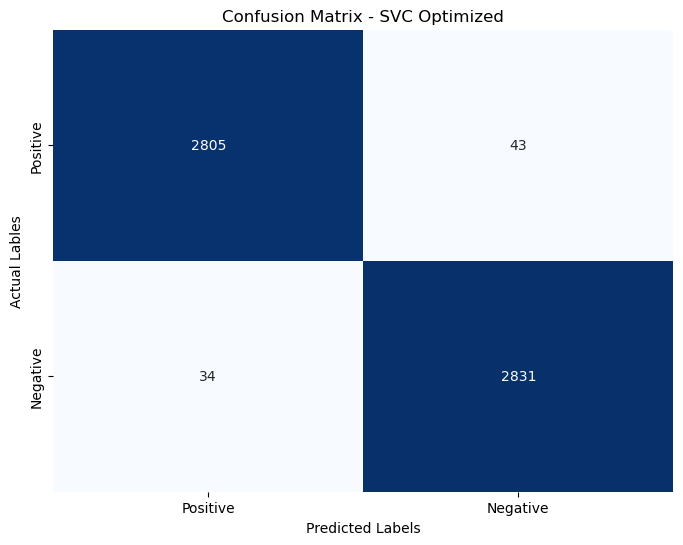

              precision    recall  f1-score   support

    Negative       0.99      0.98      0.99      2848
    Positive       0.99      0.99      0.99      2865

    accuracy                           0.99      5713
   macro avg       0.99      0.99      0.99      5713
weighted avg       0.99      0.99      0.99      5713



In [366]:
svc_2 = SVC(C=100, decision_function_shape='ovo', gamma='scale', kernel='rbf', random_state=42)
model_svc = svc_2.fit(X_train, y_train)

y_pred_train = model.predict(X_train)
y_pred_svc_2 = svc_2.predict(X_test)

accuracy_train = accuracy_score(y_train, y_pred_train)

print(f'Train Accuracy: {accuracy_train}')
classification_eval(y_test, y_pred_svc_2, 'SVC Optimized')

In [368]:
pickle.dump(model_svc, open('model_svc.pkl', 'wb'))